### Imports

In [2]:
import pandas as pd
pd.set_option('display.max_columns', None)

import numpy as np

import matplotlib.pyplot as plt
%matplotlib inline

import seaborn as sns
# Set the default seaborn style to 'darkgrid'
sns.set_theme(style="darkgrid")

# Set up with a higher resolution screen (useful on Mac)
%config InlineBackend.figure_format = 'retina'

### Exploratory data analysis - part 1
Aðeins að skoða grunngögn og vinnslu á þeim og þannig stöff.

Virðist vera að við joinum á `HEINUM` til að sameina **kaupskra** og **stadfangaskra**, og svo er `FASTNUM` unique id fyrir hverja og eina fasteign.

Lýsingar á gögnunum: https://www.fasteignaskra.is/gogn/grunngogn-til-nidurhals/kaupskra-fasteigna/eigindalysing-kaupskrar & https://www.fasteignaskra.is/library/Samnyttar-skrar-/Fyrirtaeki-stofnanir/Nidurhal/Sta%C3%B0fangaskr%C3%A1%20eigindal%C3%BDsing.pdf

In [3]:
# Paths to the datasets
kaupskra_path = 'kaupskra.csv.zip'
stadfangaskra_path = 'stadfangaskra.csv.zip'

# Reading in kaupskra and stadfangaskra data
kaupskra = pd.read_csv(kaupskra_path, encoding='latin1', sep=';')
stadfangaskra = pd.read_csv(stadfangaskra_path, encoding='utf-8', sep=',')

# Lets join kaupskra and stadfangaskra together on HEINUM to form our final dataset
data = pd.merge(kaupskra, stadfangaskra, on='HEINUM') # inner join
data.shape

(193005, 52)

In [4]:
data.head()

,FAERSLUNUMER,EMNR,SKJALANUMER,FASTNUM,HEIMILISFANG,POSTNR_x,HEINUM,SVFN,SVEITARFELAG,UTGDAG,THINGLYSTDAGS,KAUPVERD,FASTEIGNAMAT,FASTEIGNAMAT_GILDANDI,BRUNABOTAMAT_GILDANDI,BYGGAR,FEPILOG,EINFLM,LOD_FLM,LOD_FLMEIN,FJHERB,TEGUND,FULLBUID,ONOTHAEFUR_SAMNINGUR,FID,HNITNUM,SVFNR,BYGGD,LANDNR,MATSNR,POSTNR_y,HEITI_NF,HEITI_TGF,HUSNR,BOKST,VIDSK,SERHEITI,DAGS_INN,DAGS_LEIDR,GAGNA_EIGN,TEGHNIT,YFIRFARID,YFIRF_HEITI,ATH,NAKV_XY,HNIT,N_HNIT_WGS84,E_HNIT_WGS84,NOTNR,LM_HEIMILISFANG,VEF_BIRTING,HUSMERKING
0,500342,411,R-005069/2006,2067729,Melabraut 3,170,1024617,1100,Seltjarnarnesbær,2006-05-08 00:00:00.0,2006-05-10 09:22:39.0,25500,19610,90600.0,53950.0,1963,010101,102.3,NaN,NaN,3.0,Fjölbýli,1,1,Stadfangaskra.fid-24f8547a_18ebb06342d_-3298,10032272,1100,1,117368,NaN,170,Melabraut,Melabraut,3.0,NaN,NaN,NaN,2007-09-07,2009-02-23,HMS,0.0,0.0,NaN,NaN,NaN,POINT (354080 408959),64.152289,-21.999498,956.0,Melabraut 3 (117368),Melabraut 3 (117368),3
1,679963,441,D-006418/2021,2067730,Melabraut 3,170,1024617,1100,Seltjarnarnesbær,2021-10-21 00:00:00.0,2021-10-25 15:18:50.0,50000,62250,100400.0,67900.0,1963,010201,139.8,820.0,m²,2.0,Fjölbýli,1,0,Stadfangaskra.fid-24f8547a_18ebb06342d_-3298,10032272,1100,1,117368,NaN,170,Melabraut,Melabraut,3.0,NaN,NaN,NaN,2007-09-07,2009-02-23,HMS,0.0,0.0,NaN,NaN,NaN,POINT (354080 408959),64.152289,-21.999498,956.0,Melabraut 3 (117368),Melabraut 3 (117368),3
2,680332,441,A-009807/2021,2067729,Melabraut 3,170,1024617,1100,Seltjarnarnesbær,2021-11-01 00:00:00.0,2021-11-04 15:14:48.0,44000,48850,90600.0,53950.0,1963,010101,102.3,820.0,m²,3.0,Fjölbýli,1,0,Stadfangaskra.fid-24f8547a_18ebb06342d_-3298,10032272,1100,1,117368,NaN,170,Melabraut,Melabraut,3.0,NaN,NaN,NaN,2007-09-07,2009-02-23,HMS,0.0,0.0,NaN,NaN,NaN,POINT (354080 408959),64.152289,-21.999498,956.0,Melabraut 3 (117368),Melabraut 3 (117368),3
3,702045,441,B-005352/2023,2526176,Melabraut 3,170,1024617,1100,Seltjarnarnesbær,2023-06-27 00:00:00.0,2023-08-03 12:17:21.0,119900,10200,99350.0,67950.0,,010301,129.5,820.0,m²,2.0,Fjölbýli,1,1,Stadfangaskra.fid-24f8547a_18ebb06342d_-3298,10032272,1100,1,117368,NaN,170,Melabraut,Melabraut,3.0,NaN,NaN,NaN,2007-09-07,2009-02-23,HMS,0.0,0.0,NaN,NaN,NaN,POINT (354080 408959),64.152289,-21.999498,956.0,Melabraut 3 (117368),Melabraut 3 (117368),3
4,705839,441,B-010279/2023,2067729,Melabraut 3,170,1024617,1100,Seltjarnarnesbær,2023-11-15 00:00:00.0,2023-11-25 14:57:33.0,86500,84300,90600.0,53950.0,2023,010101,107.2,820.0,m²,3.0,Fjölbýli,1,1,Stadfangaskra.fid-24f8547a_18ebb06342d_-3298,10032272,1100,1,117368,NaN,170,Melabraut,Melabraut,3.0,NaN,NaN,NaN,2007-09-07,2009-02-23,HMS,0.0,0.0,NaN,NaN,NaN,POINT (354080 408959),64.152289,-21.999498,956.0,Melabraut 3 (117368),Melabraut 3 (117368),3


In [5]:
print('Oldest record is from', data['THINGLYSTDAGS'].min())
print('Newest record is from', data['THINGLYSTDAGS'].max())

Oldest record is from 2006-05-08 08:19:48.0
Newest record is from 2024-03-20 15:32:57.0


In [6]:
data['THINGLYSTDAGS'] = pd.to_datetime(data['THINGLYSTDAGS']) # Converting to datetime

In [7]:
mun_count = data.groupby('SVEITARFELAG').size().reset_index(name='Count').sort_values(by='Count', ascending=False)
focus_municipalities = mun_count.head(16)['SVEITARFELAG'].tolist()


In [8]:
# Plot the sveitarfelag distribution
municipalities = data['SVEITARFELAG'].unique()
print('Total number of municipalities are', len(municipalities))

Total number of municipalities are 64


In [9]:
data = data.loc[data['SVEITARFELAG'].isin(focus_municipalities)]
data = data.loc[data['ONOTHAEFUR_SAMNINGUR'] == 0]

### Exploratory data analysis - part 2
Teikna upp gröf og þannig stuff.

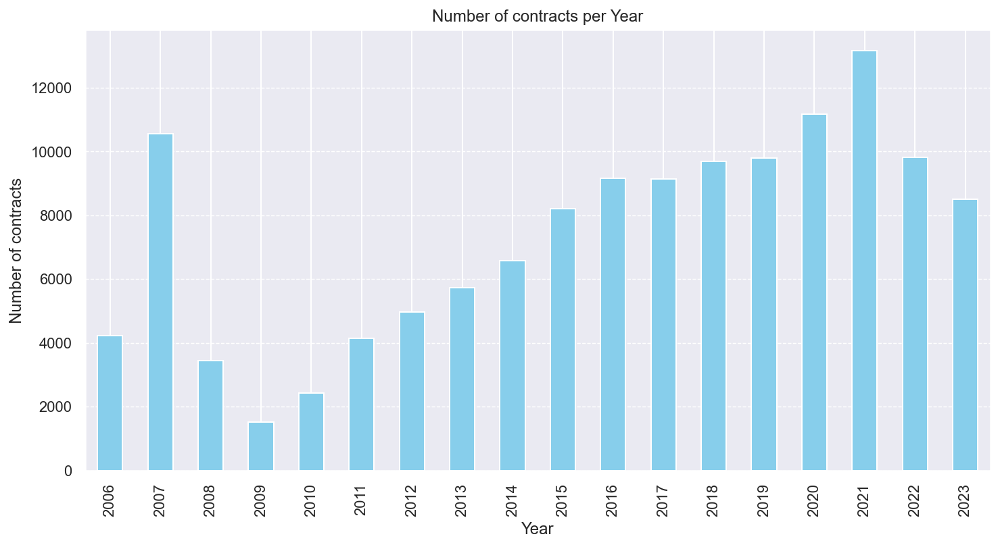

In [10]:
import pandas as pd
import matplotlib.pyplot as plt

# Extract the Year temporarily and count records, excluding 2024
yearly_counts = data['THINGLYSTDAGS'].dt.year[data['THINGLYSTDAGS'].dt.year != 2024].value_counts()

# Sort the years
yearly_counts = yearly_counts.sort_index()

# Plot the data
plt.figure(figsize=(12, 6))  # Set the figure size for better readability
yearly_counts.plot(kind='bar', color='skyblue')  # Create a bar chart
plt.title('Number of contracts per Year')
plt.xlabel('Year')
plt.ylabel('Number of contracts')
plt.xticks(rotation=90)  # Rotate x-axis labels for better readability
plt.grid(axis='y', linestyle='--', linewidth=0.7)  # Add horizontal grid lines
plt.show()

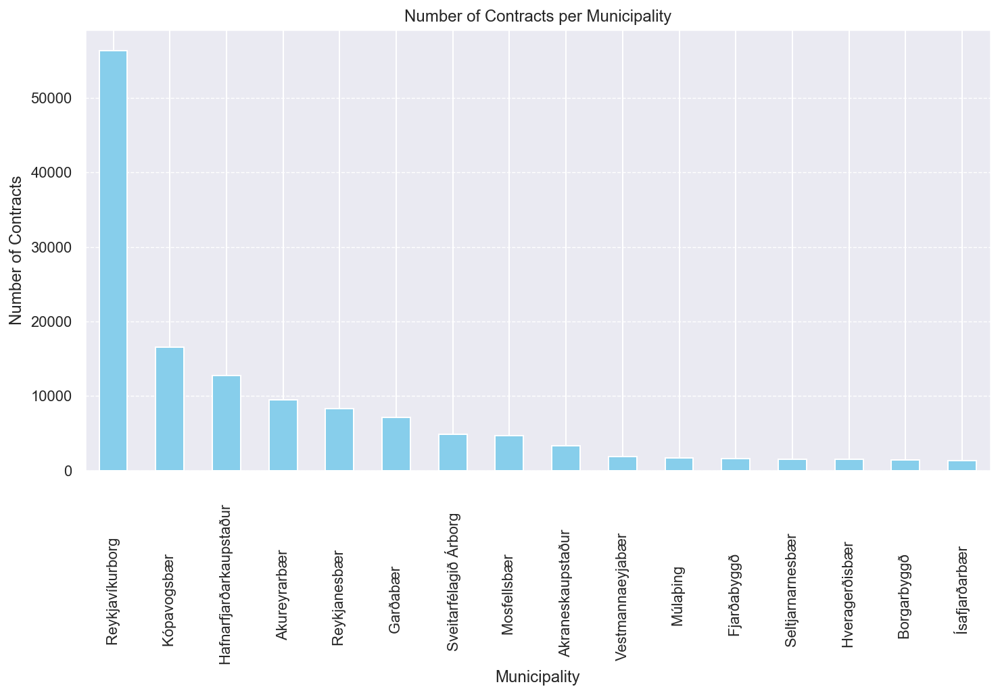

In [11]:
# Extract the municipalities data
municipalities_counts = data['SVEITARFELAG'].value_counts()

# The data is already sorted by count in descending order due to value_counts()

# Plot the data
plt.figure(figsize=(12, 6))  # Set the figure size for better readability
municipalities_counts.plot(kind='bar', color='skyblue')  # Create a bar chart
plt.title('Number of Contracts per Municipality')
plt.xlabel('Municipality')
plt.ylabel('Number of Contracts')
plt.xticks(rotation=90)  # Rotate x-axis labels for better readability
plt.grid(axis='y', linestyle='--', linewidth=0.7)  # Add horizontal grid lines
plt.show()

In [12]:
import numpy as np
import pandas as pd
import folium


# Filter data between 2016-06-01 and 2016-07-31
map_data = data[(data['UTGDAG'] >= '2016-01-01') & (data['UTGDAG'] <= '2016-12-31')][['HEIMILISFANG', 'N_HNIT_WGS84', 'E_HNIT_WGS84']]

iceland_map = folium.Map(location=[64.9631, -19.0208], zoom_start=6, tiles='CartoDB Positron')

# Add smaller markers/dots for incidents
for index, row in map_data.iterrows():
    folium.CircleMarker(
        location=[row['N_HNIT_WGS84'], row['E_HNIT_WGS84']],
        radius=1,  # Adjust the radius as needed
        color='red',
        fill=True,
        fill_color='red',
        popup=row['HEIMILISFANG']
    ).add_to(iceland_map)

iceland_map


# Hér að neðan byrjar explainer notebook-ið, en hægt að nota dót að ofan

# Motivation
- What is your dataset?
- Why did you choose this/these particular dataset(s)?
- What was your goal for the end user's experience?

The main dataset that was used in this project is an open-source dataset containing property registration data for the Icelandic housing market, which was downloaded from this source: https://www.fasteignaskra.is/gogn/grunngogn-til-nidurhals. It contains information on historical purchase prices, property address, postal codes, square meters, numbner of rooms, type of hosuing, etc. To obtain geological data a supplementary dataset was needed containing latitude and longitude values for each property, and by merging these two datasets together the final dataset was created and ending being 75.4 MB in size.

The idea was to explore the Icelandic Housing market – which is a niche market – but as the team members are from Iceland, we thought it would be a great idea as the housing market is always relevant and the ideas of our project can be used for other housing market data, hoping to give insights to potential buyers, as it is for most people the main investment of their life.

The goal was to create a compelling and insightful story of the Icelandic housing market. Looking at price changes over the years, best buys and just in general fun things to look at, like what property has been most often bought/sold over the span of 18 years.

# Basic stats
Let's understand the dataset better:
- Write about your choices in data cleaning and preprocessing
- Write a short section that discusses the dataset stats, containing key points/plots from your exploratory data analysis.

To better understand the dataset, we utilized the set of tools acquired during the course. The sections **Data cleaning and preprocessing** and **Data stats** take you through it.

## Data cleaning and preprocessing

We started off with importing necessary packages and reading in the datasets and merging them into a single dataset and viewing the dataset.

In [13]:
import pandas as pd
pd.set_option('display.max_columns', None)

import numpy as np

import matplotlib.pyplot as plt
%matplotlib inline

import seaborn as sns
# Set the default seaborn style to 'darkgrid'
sns.set_theme(style="darkgrid")

# Set up with a higher resolution screen (useful on Mac)
%config InlineBackend.figure_format = 'retina'

In [14]:
# Paths to the datasets
kaupskra_path = 'kaupskra.csv.zip'
stadfangaskra_path = 'stadfangaskra.csv.zip'

# Reading in kaupskra and stadfangaskra data
kaupskra = pd.read_csv(kaupskra_path, encoding='latin1', sep=';')
stadfangaskra = pd.read_csv(stadfangaskra_path, encoding='utf-8', sep=',')

# Lets join kaupskra and stadfangaskra together on HEINUM to form our final dataset
data = pd.merge(kaupskra, stadfangaskra, on='HEINUM') # inner join
data.shape

(193005, 52)

In [16]:
# Taking a quick look at the data we have
data.head()


,FAERSLUNUMER,EMNR,SKJALANUMER,FASTNUM,HEIMILISFANG,POSTNR_x,HEINUM,SVFN,SVEITARFELAG,UTGDAG,THINGLYSTDAGS,KAUPVERD,FASTEIGNAMAT,FASTEIGNAMAT_GILDANDI,BRUNABOTAMAT_GILDANDI,BYGGAR,FEPILOG,EINFLM,LOD_FLM,LOD_FLMEIN,FJHERB,TEGUND,FULLBUID,ONOTHAEFUR_SAMNINGUR,FID,HNITNUM,SVFNR,BYGGD,LANDNR,MATSNR,POSTNR_y,HEITI_NF,HEITI_TGF,HUSNR,BOKST,VIDSK,SERHEITI,DAGS_INN,DAGS_LEIDR,GAGNA_EIGN,TEGHNIT,YFIRFARID,YFIRF_HEITI,ATH,NAKV_XY,HNIT,N_HNIT_WGS84,E_HNIT_WGS84,NOTNR,LM_HEIMILISFANG,VEF_BIRTING,HUSMERKING
0,500342,411,R-005069/2006,2067729,Melabraut 3,170,1024617,1100,Seltjarnarnesbær,2006-05-08 00:00:00.0,2006-05-10 09:22:39.0,25500,19610,90600.0,53950.0,1963,010101,102.3,NaN,NaN,3.0,Fjölbýli,1,1,Stadfangaskra.fid-24f8547a_18ebb06342d_-3298,10032272,1100,1,117368,NaN,170,Melabraut,Melabraut,3.0,NaN,NaN,NaN,2007-09-07,2009-02-23,HMS,0.0,0.0,NaN,NaN,NaN,POINT (354080 408959),64.152289,-21.999498,956.0,Melabraut 3 (117368),Melabraut 3 (117368),3
1,679963,441,D-006418/2021,2067730,Melabraut 3,170,1024617,1100,Seltjarnarnesbær,2021-10-21 00:00:00.0,2021-10-25 15:18:50.0,50000,62250,100400.0,67900.0,1963,010201,139.8,820.0,m²,2.0,Fjölbýli,1,0,Stadfangaskra.fid-24f8547a_18ebb06342d_-3298,10032272,1100,1,117368,NaN,170,Melabraut,Melabraut,3.0,NaN,NaN,NaN,2007-09-07,2009-02-23,HMS,0.0,0.0,NaN,NaN,NaN,POINT (354080 408959),64.152289,-21.999498,956.0,Melabraut 3 (117368),Melabraut 3 (117368),3
2,680332,441,A-009807/2021,2067729,Melabraut 3,170,1024617,1100,Seltjarnarnesbær,2021-11-01 00:00:00.0,2021-11-04 15:14:48.0,44000,48850,90600.0,53950.0,1963,010101,102.3,820.0,m²,3.0,Fjölbýli,1,0,Stadfangaskra.fid-24f8547a_18ebb06342d_-3298,10032272,1100,1,117368,NaN,170,Melabraut,Melabraut,3.0,NaN,NaN,NaN,2007-09-07,2009-02-23,HMS,0.0,0.0,NaN,NaN,NaN,POINT (354080 408959),64.152289,-21.999498,956.0,Melabraut 3 (117368),Melabraut 3 (117368),3
3,702045,441,B-005352/2023,2526176,Melabraut 3,170,1024617,1100,Seltjarnarnesbær,2023-06-27 00:00:00.0,2023-08-03 12:17:21.0,119900,10200,99350.0,67950.0,,010301,129.5,820.0,m²,2.0,Fjölbýli,1,1,Stadfangaskra.fid-24f8547a_18ebb06342d_-3298,10032272,1100,1,117368,NaN,170,Melabraut,Melabraut,3.0,NaN,NaN,NaN,2007-09-07,2009-02-23,HMS,0.0,0.0,NaN,NaN,NaN,POINT (354080 408959),64.152289,-21.999498,956.0,Melabraut 3 (117368),Melabraut 3 (117368),3
4,705839,441,B-010279/2023,2067729,Melabraut 3,170,1024617,1100,Seltjarnarnesbær,2023-11-15 00:00:00.0,2023-11-25 14:57:33.0,86500,84300,90600.0,53950.0,2023,010101,107.2,820.0,m²,3.0,Fjölbýli,1,1,Stadfangaskra.fid-24f8547a_18ebb06342d_-3298,10032272,1100,1,117368,NaN,170,Melabraut,Melabraut,3.0,NaN,NaN,NaN,2007-09-07,2009-02-23,HMS,0.0,0.0,NaN,NaN,NaN,POINT (354080 408959),64.152289,-21.999498,956.0,Melabraut 3 (117368),Melabraut 3 (117368),3


The dataset contains 193.005 records of property registration with 52 columns of different data, some more relevant and useful than other. By taking a look at descriptions of these different columns we were able to identify the most important features. Here are links to the descriptions, but they are in Icelandic so google translate comes in handy: https://www.fasteignaskra.is/gogn/grunngogn-til-nidurhals/kaupskra-fasteigna/eigindalysing-kaupskrar & https://www.fasteignaskra.is/library/Samnyttar-skrar-/Fyrirtaeki-stofnanir/Nidurhal/Sta%C3%B0fangaskr%C3%A1%20eigindal%C3%BDsing.pdf.

The final set of columns/features we chose are these (english translation of the column to the right of the back slash):
- `FASTNUM/property_number`: Property identification number
- `HEIMILISFANG/adress`: Address 
- `POSTNR_x/postal_code`: Postal code
- `SVEITARFELAG/municipality`: Municipality
- `THINGLYSTDAGS/notarized_date`: Date of registration of purchase agreement (notarized agreement)
- `KAUPVERD/purchase_price`: Purchase price of property
- `FASTEIGNAMAT/property_value`: Property value/assessment at the time of the purchase agreement
- `FASTEIGNAMAT_GILDANDI/current_property_value`: Current property value/assessment
- `BRUNABOTAMAT_GILDANDI/insurance_payout`: Current fire compensation assessment or insurance payout if destroyed
- `BYGGAR/year_built`: Year of construction/property built
- `EINFLM/size_square_meters`: Unit area of property
- `LOD_FLM/plot_size`: Plot size
- `LOD_FLMEIN/plot_size_units`: Plot size units (not all plots given in same units)
- `FJHERB/number_of_rooms`: Number of rooms
- `TEGUND/type`: Property type
- `ONOTHAEFUR_SAMNINGUR/unenforcable_contract`: If contract is unenforceable then 1 otherwise 0
- `N_HNIT_WGS84/latitude`: North coordinates in WGS84 latitude
- `E_HNIT_WGS84/longitude`: East coordinates in WGS84 longitude
- `FULLBUID/complete`: If the property is complete then 1 otherwise 0

In [17]:
## Data cleaning and pre-processing ##

# List of features we want to work with
features = ['FASTNUM','HEIMILISFANG','POSTNR_x','SVEITARFELAG','THINGLYSTDAGS','KAUPVERD','FASTEIGNAMAT'
           ,'FASTEIGNAMAT_GILDANDI','BRUNABOTAMAT_GILDANDI','BYGGAR','EINFLM','LOD_FLM','LOD_FLMEIN','FJHERB'
           ,'TEGUND','ONOTHAEFUR_SAMNINGUR','N_HNIT_WGS84','E_HNIT_WGS84','FULLBUID']

# Filtering on those columns
data = data[features]

For better code transparency we decided to translate the column names from Icelandic to English. Also, translating the "types" of housing from Icelandic to English and droping all rows that have houses of type "Other" or "Garage/Shed" as it was of less interest to us.

In [18]:
# Renaming columns - translating to English
data.rename(columns={'FASTNUM': 'property_number'}, inplace=True)
data.rename(columns={'HEIMILISFANG': 'address'}, inplace=True)
data.rename(columns={'POSTNR_x': 'postal_code'}, inplace=True)
data.rename(columns={'SVEITARFELAG': 'municipality'}, inplace=True)
data.rename(columns={'THINGLYSTDAGS': 'notarized_date'}, inplace=True)
data.rename(columns={'KAUPVERD': 'purchase_price'}, inplace=True)
data.rename(columns={'FASTEIGNAMAT': 'property_value'}, inplace=True)
data.rename(columns={'FASTEIGNAMAT_GILDANDI': 'current_property_value'}, inplace=True)
data.rename(columns={'BRUNABOTAMAT_GILDANDI': 'insurance_payout'}, inplace=True)
data.rename(columns={'BYGGAR': 'year_built'}, inplace=True)
data.rename(columns={'EINFLM': 'size_square_meters'}, inplace=True)
data.rename(columns={'LOD_FLM': 'plot_size'}, inplace=True)
data.rename(columns={'LOD_FLMEIN': 'plot_size_units'}, inplace=True)
data.rename(columns={'FJHERB': 'number_of_rooms'}, inplace=True)
data.rename(columns={'TEGUND': 'type'}, inplace=True)
data.rename(columns={'ONOTHAEFUR_SAMNINGUR': 'unenforcable_contract'}, inplace=True)
data.rename(columns={'HEINUM': 'designation_number'}, inplace=True)
data.rename(columns={'N_HNIT_WGS84': 'latitude'}, inplace=True)
data.rename(columns={'E_HNIT_WGS84': 'longitude'}, inplace=True)
data.rename(columns={'FULLBUID': 'complete'}, inplace=True)

/Users/kristjangudjonsson/opt/anaconda3/lib/python3.8/site-packages/pandas/core/frame.py:4296: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().rename(


In [19]:
data['type'] = data['type'].apply(lambda value: 'Apartment' if value == 'Fjölbýli' 
 else ('Plex/semi house' if value == 'Sérbýli' else ('Garage/Shed' if value == 'Bílskúr/skúr' 
 else ('Commercial property' if value == 'Atvinnuhúsnæði' else ('Private house' if value == 'Einbýli'
 else ('Summer house' if value == 'Sumarhús' else ('Other' if value == 'Annað' else value)))))))

data = data[~data['type'].isin(['Other', 'Garage/Shed', 'Commercial property', 'Summer house'])]

# Converting to int
data['year_built'] = pd.to_numeric(data['year_built'], errors='coerce').fillna(np.nan).astype(float).astype('Int64')

<ipython-input-19-2560921ff0b6>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['type'] = data['type'].apply(lambda value: 'Apartment' if value == 'Fjölbýli'


In [20]:
data['price_per_sq_meter'] = data['purchase_price'] / data['size_square_meters']

We then did the common convertion of setting the date columns to be in datetime as well as stripping whitespace from all string columns.

In [21]:
# Converting the date column to datetime
data['notarized_date'] = pd.to_datetime(data['notarized_date'])

# Selecting string columns and applying str.strip() to get rid off white space
string_columns = data.select_dtypes(include=[object])
for column in string_columns:
    data[column] = data[column].str.strip()

To work with relevant property data we decided to filter on `ONOTHAEFUR_SAMNINGUR` = 0 since we only wanted usable records.

In [22]:
data = data.loc[data['unenforcable_contract'] == 0] # Filter out unusable records

Above is the cleaned and processed dataset that we analyze further in the coming sections.

## Data stats
In our exploratory data analysis we wanted to understand in more detail the distribution of the dataset for different timeperiods and different municpalities.

We started by looking at the time horizon of our historical property contracts and how many municipalites are in Iceland discovering that the data is from May 2006 to March 2024, containing data for 64 different municipalities.

In [23]:
print('Oldest contract is from', data['notarized_date'].min().strftime('%Y-%m-%d'))
print('Newest contract is from', data['notarized_date'].max().strftime('%Y-%m-%d'))

mun = data['municipality'].unique()
print(f'\nThere are {len(mun)} municipalities in Iceland')

Oldest contract is from 2006-05-09
Newest contract is from 2024-03-20

There are 62 municipalities in Iceland


Then we plotted a bar chart showing how many historical property contracts have been made in each municipality.

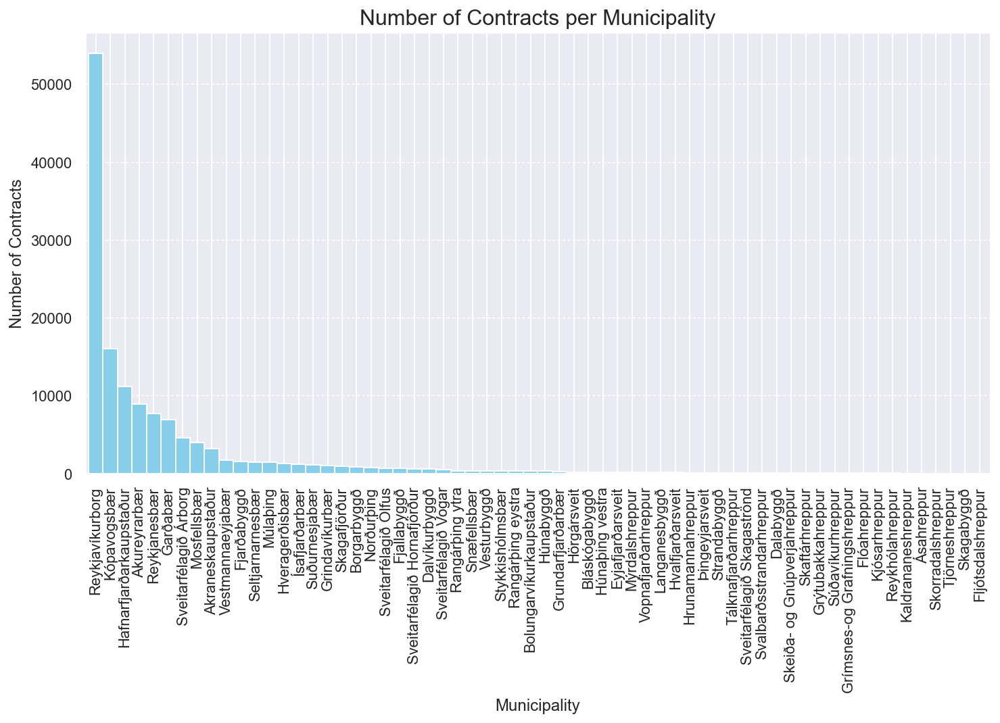

In [24]:
# Extract the municipalities data
municipalities_counts = data['municipality'].value_counts()

# The data is already sorted by count in descending order due to value_counts()

# Plot the data
plt.figure(figsize=(12, 6))  # Set the figure size for better readability
# Create a bar chart with thicker bars (default width is 0.8, so try 1 for thicker bars)
municipalities_counts.plot(kind='bar', color='skyblue', width=1)
plt.title('Number of Contracts per Municipality', fontsize=16)  # Bigger title font size
plt.xlabel('Municipality')
plt.ylabel('Number of Contracts')
plt.xticks(rotation=90)  # Rotate x-axis labels for better readability
plt.grid(axis='y', linestyle='--', linewidth=0.7)  # Add horizontal grid lines
plt.show()


No surprise that **Reykjavíkurborg**, the capital of Iceland, has the far greatest number of contracts, and smaller towns in the countryside have very few in comparison. By looking at the graph, and applying domain knowledge as "experts" in being from Iceland, we chose our "focus" municipalites to be the top 16 with regards to number of contracts. Most of them are from the capital region but we also have big towns in Eastern and Northern parts of Iceland.

In [25]:
mun_count = data.groupby('municipality').size().reset_index(name='Count').sort_values(by='Count', ascending=False)
focus_municipalities = mun_count.head(16)['municipality'].tolist()
data = data.loc[data['municipality'].isin(focus_municipalities)]

To further understand the fundamental distribution of our dataset we decided to set plot a bar chart showing the number of purchase agreements within our foucus municipalities and also the historical number of contracts per year.

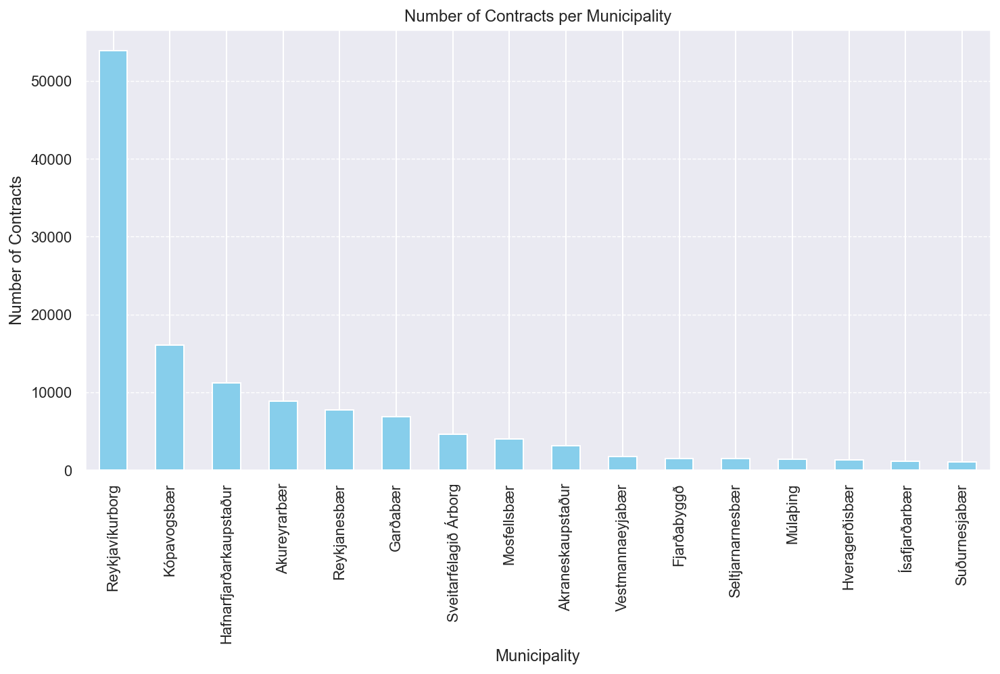

In [26]:
# Extract the municipalities data
municipalities_counts = data['municipality'].value_counts()

# The data is already sorted by count in descending order due to value_counts()

# Plot the data
plt.figure(figsize=(12, 6))  # Set the figure size for better readability
municipalities_counts.plot(kind='bar', color='skyblue')  # Create a bar chart
# for i, value in enumerate(municipalities_counts):
#     plt.text(i, value+700, "{:,}".format(value), ha='center')
plt.title('Number of Contracts per Municipality')
plt.xlabel('Municipality')
plt.ylabel('Number of Contracts')
plt.xticks(rotation=90)  # Rotate x-axis labels for better readability
plt.grid(axis='y', linestyle='--', linewidth=0.7)  # Add horizontal grid lines
plt.show()

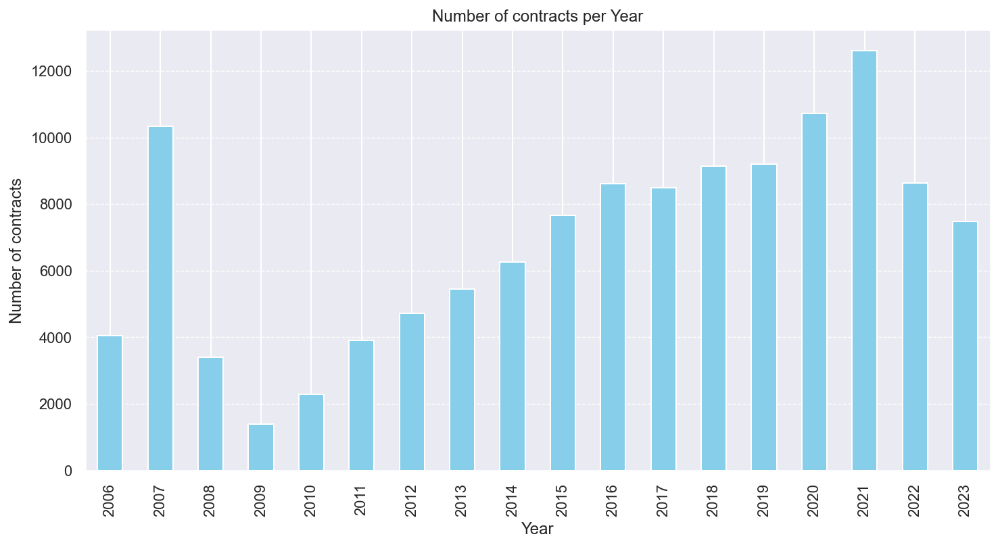

In [27]:
# Extract the Year temporarily and count records, excluding 2024
yearly_counts = data['notarized_date'].dt.year[data['notarized_date'].dt.year != 2024].value_counts()

# Sort the years
yearly_counts = yearly_counts.sort_index()

# Plot the data
plt.figure(figsize=(12, 6))  # Set the figure size for better readability
yearly_counts.plot(kind='bar', color='skyblue')  # Create a bar chart
plt.title('Number of contracts per Year')
plt.xlabel('Year')
plt.ylabel('Number of contracts')
plt.xticks(rotation=90)  # Rotate x-axis labels for better readability
plt.grid(axis='y', linestyle='--', linewidth=0.7)  # Add horizontal grid lines
plt.show()

Looking at the number of contracts per municipality plot we see in greater detail the distribution of our focus municipalities, the top 3 are from the capital region but in 4th place we have **Akureyrarbær** which is the largest town in the North of Iceland and in 5th place we have **Reykjanesbær** which is located on the Southern Peninsula of Iceland.

The historical distribution of contracts per year reveals that there was a spike in 2007 which then drops drastically in 2008. This is most likely due to the financial crisis in 2008. From 2009 up until 2021 there is an upwards trend but now in the last 2 years it seems the housing market has cooled down from the record year of 2021.

It also made sense to plot the distribution of historical housing prices, using a histogram and logarithmic transformation and also calculate the inflation adjusted price using a consumer price index.

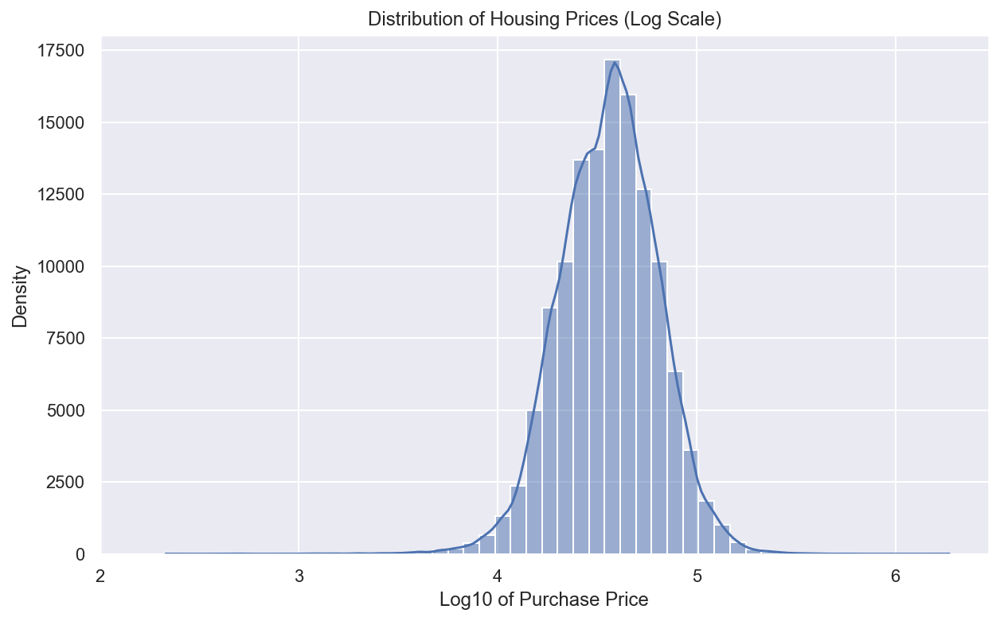

In [28]:
# Apply logarithmic transformation to the data
data['log_purchase_price'] = np.log10(data['purchase_price'])

# Plotting with logarithmic transformation
plt.figure(figsize=(10, 6))
sns.histplot(data['log_purchase_price'], kde=True, bins=50)
plt.title('Distribution of Housing Prices (Log Scale)')
plt.xlabel('Log10 of Purchase Price')
plt.ylabel('Density')
plt.xticks(range(int(data['log_purchase_price'].min()), int(data['log_purchase_price'].max()) + 1))  # Customize x-axis ticks
plt.show()

In [29]:
# Reading the CPI data
cpi_data = pd.read_csv('cpi_data.csv', sep=';', header=0)
cpi_data['Date'] = pd.to_datetime(cpi_data['Date'].str.replace('M', ''), format='%Y%m')

In [30]:
# Create new columns for year and month
data['year_month'] = data['notarized_date'].dt.to_period('M')
cpi_data['year_month'] = cpi_data['Date'].dt.to_period('M')

# Merge the DataFrames on year_month
data_inflation = pd.merge(data, cpi_data, on='year_month')
#Convert to float
data_inflation['CPI'] = data_inflation['CPI'].astype(float)


In [31]:
newest_date = data_inflation['notarized_date'].max()
# Base CPI value, the newest
cpi_value = data_inflation.loc[data_inflation['notarized_date'] == newest_date, 'CPI'].values[0]
data_inflation['purchase_price_inf_adj'] = data_inflation['purchase_price'] * (1 + ((cpi_value - data_inflation['CPI'])/data_inflation['CPI']))

In [32]:
data_inflation.loc[data_inflation['purchase_price'].idxmax()]

property_number                         2515583
address                           Austurhólar 4
postal_code                                 800
municipality              Sveitarfélagið Árborg
notarized_date              2022-12-28 10:42:33
purchase_price                          1870000
property_value                            80000
current_property_value                   807750
insurance_payout                              0
year_built                                 <NA>
size_square_meters                       3455.8
plot_size                                3921.8
plot_size_units                              m²
number_of_rooms                              87
type                                  Apartment
unenforcable_contract                         0
latitude                                63.9295
longitude                               -20.974
complete                                      1
price_per_sq_meter                      541.119
log_purchase_price                      

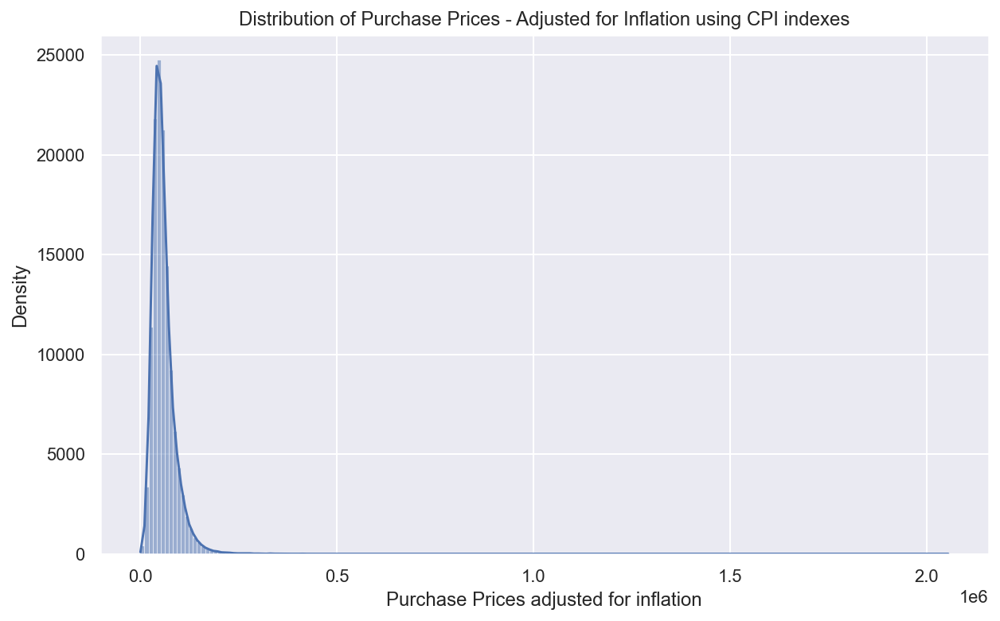

In [34]:
# Plotting with adjusted prices
plt.figure(figsize=(10, 6))
sns.histplot(data_inflation['purchase_price_inf_adj'], kde=True, bins=200)
plt.title('Distribution of Purchase Prices - Adjusted for Inflation using CPI indexes')
plt.xlabel('Purchase Prices adjusted for inflation')
plt.ylabel('Density')
plt.show()

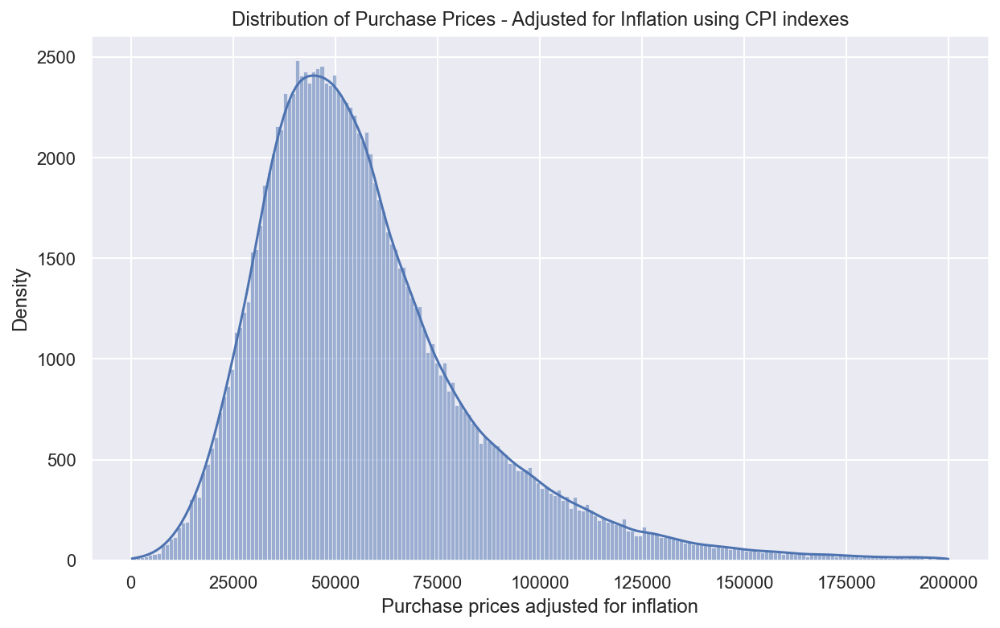

In [35]:
# Filter the data to include only purchase prices <= 500,000
filtered_data = data_inflation[data_inflation['purchase_price_inf_adj'] <= 200000]

# Plotting with adjusted prices
plt.figure(figsize=(10, 6))
sns.histplot(filtered_data['purchase_price_inf_adj'], kde=True, bins=200)
plt.title('Distribution of Purchase Prices - Adjusted for Inflation using CPI indexes')
plt.xlabel('Purchase prices adjusted for inflation')
plt.ylabel('Density')
plt.show()


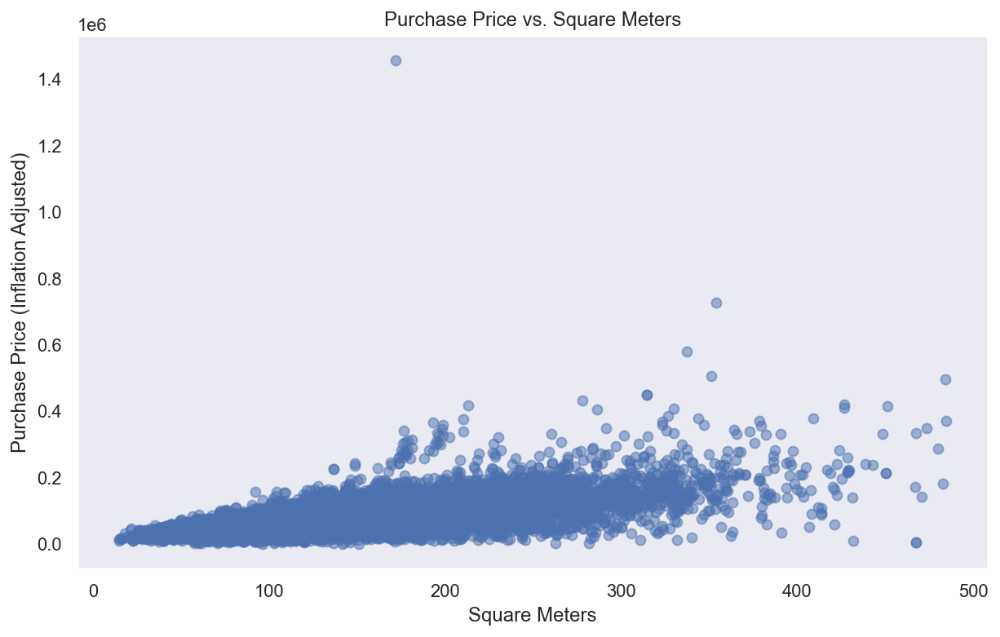

In [36]:
# Scatter plot of purchase price adjusted to inflation to the square meters of the property
filter_data = data_inflation[(data_inflation['size_square_meters'] <= 500) & (data_inflation['notarized_date'] >= '2020-01-01')]

plt.figure(figsize=(10, 6))
plt.scatter(filter_data['size_square_meters'], filter_data['purchase_price_inf_adj'], alpha=0.5)
plt.title('Purchase Price vs. Square Meters')
plt.xlabel('Square Meters')
plt.ylabel('Purchase Price (Inflation Adjusted)')
plt.grid(False)
plt.show()


Since we have latitude and longitude data of all registered residents we wanted to visualize what regions in Iceland have higher density, and we did that both with drawing dots for each contract and with a heatmap

In [37]:
import numpy as np
import pandas as pd
import folium


# Filter data between 2021-01-01 and 2016-07-31
map_data = data[(data['notarized_date'] >= '2021-01-01') & (data['notarized_date'] <= '2021-12-31')][['address', 'latitude', 'longitude']]

iceland_map = folium.Map(location=[64.9631, -19.0208], zoom_start=6, tiles='CartoDB Positron')

# Add smaller markers/dots for incidents
for index, row in map_data.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=1,  # Adjust the radius as needed
        color='red',
        fill=True,
        fill_color='red',
        popup=row['address']
    ).add_to(iceland_map)

iceland_map

In [ ]:
import numpy as np
import pandas as pd
import folium
from folium.plugins import HeatMap

# Filter data between 2016-06-01 and 2016-07-31
map_data = data[(data['notarized_date'] >= '2016-01-01') & (data['notarized_date'] <= '2016-12-31')][['address', 'latitude', 'longitude']]

iceland_map = folium.Map(location=[64.9631, -19.0208], zoom_start=6, tiles='CartoDB Positron')

heat_data = [[row['latitude'], row['longitude']] for index, row in map_data.iterrows()]

# Create a HeatMap layer and add it to the map
HeatMap(heat_data, radius=15,blur=10).add_to(iceland_map)

# Display the map
iceland_map


# Data Analysis
- Describe your data analysis and explain what you've learned about the dataset.
- If relevant, talk about your machine-learning.


### Price trend - interactive plot with bokeh
Looking at price change per municipality. So it makes the most sense, some standardization is needed

In [38]:
# Importing packages
import pandas as pd
from bokeh.plotting import figure, show, save, output_file
from bokeh.models import ColumnDataSource, Legend
from bokeh.io import output_notebook
output_notebook()  # Display in notebook, remove if running in a standalone script

Loading BokehJS ...

In [39]:
# Calculating standardized price
price_series = {}

for municipality in focus_municipalities:
    focus = data.loc[data['municipality'] == municipality]
    #price_day = focus.groupby('notarized_date').dt.date['purchase_price'].sum().reset_index(name='Total Purchase Price')
    price_day = focus.groupby(focus['notarized_date'].dt.date)['purchase_price'].sum().reset_index(name='Total Purchase Price')
    price_day['Price Rate'] = price_day['Total Purchase Price'].rolling(365).mean()
    price_day['Standardized Price Rate'] = (price_day['Price Rate'] - price_day['Price Rate'].min()) / (price_day['Price Rate'].max() - price_day['Price Rate'].min())  # Standardization
    price_series[municipality] = price_day



In [40]:
from bokeh.palettes import Category20 as palette  # Import a palette with sufficient colors
import itertools  # For cycling through color palette if more crimes than colors

p = figure(width=740, height=500, toolbar_location=None, x_axis_type="datetime") 
p.title.text = 'Price Trends'
p.xaxis.axis_label = 'Year'
p.yaxis.axis_label = 'Standardized Price Rate'
p.xaxis.axis_label_text_font_style = 'bold'
p.yaxis.axis_label_text_font_style = 'bold'
p.xgrid.grid_line_color = None

colors = itertools.cycle(palette[20])  # Cycle through the color palette

legend_it = []
prices = {}

for municipality, color in zip(focus_municipalities, colors):
    price_data = price_series[municipality]
    source = ColumnDataSource(price_data)
    
    c = p.line('notarized_date', 'Standardized Price Rate', source=source, line_width=2, muted_alpha=0, muted=True, color=color, legend_label=municipality)

    # For interactive legends
    legend_it.append((municipality, [c]))
    prices[municipality] = c

# Remove original legend
p.legend.visible=False 

# Add custom legend
legend = Legend(items=legend_it)
legend.click_policy="mute"
legend.label_text_font_size = '8pt'
p.add_layout(legend, 'right')

prices['Reykjavíkurborg'].muted = False # By default showing Reykjavíkurborg trends
prices['Garðabær'].muted = False # By default showing Reykjavíkurborg trends
prices['Akureyrarbær'].muted = False # By default showing Reykjavíkurborg trends

show(p)

# Set the output file path and name
#output_file(f"{fig_path}/bokeh_plot.html", title="Price Trends")
#save(p)


In [41]:
# Calculating standardized price per type of houses over the years
price_series = {}

filtered_data = data.loc[(data['type'] != 'Summer house')]

for housing_type in data['type'].unique():
    focus = filtered_data.loc[filtered_data['type'] == housing_type]
    price_day = focus.groupby(focus['notarized_date'].dt.date)['purchase_price'].sum().reset_index(name='Total Purchase Price')
    price_day['Price Rate'] = price_day['Total Purchase Price'].rolling(365).mean()
    price_day['Standardized Price Rate'] = (price_day['Price Rate'] - price_day['Price Rate'].min()) / (price_day['Price Rate'].max() - price_day['Price Rate'].min())  # Standardization
    price_series[housing_type] = price_day



In [43]:
p = figure(width=740, height=500, toolbar_location=None, x_axis_type="datetime") 
p.title.text = 'Price Trends'
p.xaxis.axis_label = 'Year'
p.yaxis.axis_label = 'Standardized Price Rate'
p.xaxis.axis_label_text_font_style = 'bold'
p.yaxis.axis_label_text_font_style = 'bold'
p.xgrid.grid_line_color = None

colors = itertools.cycle(palette[20])  # Cycle through the color palette

legend_it = []
prices = {}

for housing_type, color in zip(filtered_data['type'].unique(), colors):
    price_data = price_series[housing_type]
    source = ColumnDataSource(price_data)
    
    c = p.line('notarized_date', 'Standardized Price Rate', source=source, line_width=2, muted_alpha=0, muted=True, color=color, legend_label=municipality)

    # For interactive legends
    legend_it.append((housing_type, [c]))
    prices[housing_type] = c

# Remove original legend
p.legend.visible=False 

# Add custom legend
legend = Legend(items=legend_it)
legend.click_policy="mute"
legend.label_text_font_size = '8pt'
p.add_layout(legend, 'right')

show(p)

In [45]:
# Calculating standardized price per type of houses over the years
price_series = {}

capital_region_postal_codes = [
    101, 103, 104, 105, 107, 108, 109, 110, 111, 112, 113, 116, 121, 123, 124, 
    125, 127, 128, 129, 130, 132, 200, 201, 202, 203, 220, 221, 210, 270, 170, 225
]

filtered_data = data.loc[(data['type'] != 'Summer house')]

for code in capital_region_postal_codes:
    focus = filtered_data.loc[filtered_data['postal_code'].isin(capital_region_postal_codes)]
    price_day = focus.groupby(focus['notarized_date'].dt.date)['purchase_price'].sum().reset_index(name='Total Purchase Price')
    price_day['Price Rate'] = price_day['Total Purchase Price'].rolling(365).mean()
    price_day['Standardized Price Rate'] = (price_day['Price Rate'] - price_day['Price Rate'].min()) / (price_day['Price Rate'].max() - price_day['Price Rate'].min())  # Standardization
    price_series[code] = price_day


In [46]:
price_series

{101:      notarized_date  Total Purchase Price    Price Rate  \
 0        2006-05-11                 51900           NaN   
 1        2006-05-12                182550           NaN   
 2        2006-05-15                783750           NaN   
 3        2006-05-16                585250           NaN   
 4        2006-05-17                615650           NaN   
 ...             ...                   ...           ...   
 4578     2024-03-14                421000  1.571838e+06   
 4579     2024-03-15                130500  1.567875e+06   
 4580     2024-03-18                231000  1.564420e+06   
 4581     2024-03-19                155000  1.560528e+06   
 4582     2024-03-20                271400  1.556435e+06   
 
       Standardized Price Rate  
 0                         NaN  
 1                         NaN  
 2                         NaN  
 3                         NaN  
 4                         NaN  
 ...                       ...  
 4578                 0.748960  
 4579    

In [47]:
p = figure(width=740, height=500, toolbar_location=None, x_axis_type="datetime") 
p.title.text = 'Price Trends'
p.xaxis.axis_label = 'Year'
p.yaxis.axis_label = 'Standardized Price Rate'
p.xaxis.axis_label_text_font_style = 'bold'
p.yaxis.axis_label_text_font_style = 'bold'
p.xgrid.grid_line_color = None

colors = itertools.cycle(palette[20])  # Cycle through the color palette

legend_it = []
prices = {}

for code, color in zip(filtered_data['postal_code'].unique(), colors):
    price_data = price_series[code]
    source = ColumnDataSource(price_data)
    
    c = p.line('notarized_date', 'Standardized Price Rate', source=source, line_width=2, muted_alpha=0, muted=True, color=color, legend_label=municipality)

    # For interactive legends
    legend_it.append((housing_type, [c]))
    prices[housing_type] = c

# Remove original legend
p.legend.visible=False 

# Add custom legend
legend = Legend(items=legend_it)
legend.click_policy="mute"
legend.label_text_font_size = '8pt'
p.add_layout(legend, 'right')

show(p)

KeyError: 600

In [48]:
from bokeh.models import Select
import bokeh.layouts

# Create Select widgets for filtering by housing type and municipality
housing_type_select = Select(title="Housing Type:", value="All", options=["All"] + list(filtered_data['type'].unique()))
municipality_select = Select(title="Municipality:", value="All", options=["All"] + list(filtered_data['municipality'].unique()))

# Define a callback function to update the plot based on the selected filters
def update_plot(attrname, old, new):
    selected_housing_type = housing_type_select.value
    selected_municipality = municipality_select.value
    
    # Filter the data based on the selected filters
    filtered_price_data = price_series[selected_housing_type]
    filtered_price_data = filtered_price_data[filtered_price_data['municipality'] == selected_municipality]
    source.data = filtered_price_data
    
# Attach the callback function to the Select widgets
housing_type_select.on_change('value', update_plot)
municipality_select.on_change('value', update_plot)

# Create the layout for the filters and the plot
layout = bokeh.layouts.column(housing_type_select, municipality_select, p)


# Show the layout
show(layout)


You are generating standalone HTML/JS output, but trying to use real Python
callbacks (i.e. with on_change or on_event). This combination cannot work.

Only JavaScript callbacks may be used with standalone output. For more
information on JavaScript callbacks with Bokeh, see:

    https://docs.bokeh.org/en/latest/docs/user_guide/interaction/callbacks.html

Alternatively, to use real Python callbacks, a Bokeh server application may
be used. For more information on building and running Bokeh applications, see:

    https://docs.bokeh.org/en/latest/docs/user_guide/server.html



Trying to do some comparison on nr contracts and the general interest rates for indexed and non-indexed bonds as well the policy rates of the Central Bank of Iceland

Here is link to the data of the rates:https://www.sedlabanki.is/annad-efni/meginvextir-si/

In [49]:
# Reading in the csv files with the interest rates
interest_rates = pd.read_csv('/Users/kristjangudjonsson/Documents/GitHub/thg205.github.io/assets/interest_rates_banks.csv', sep=';', header=0)
policy_rates = pd.read_csv('/Users/kristjangudjonsson/Documents/GitHub/thg205.github.io/assets/policy_interest_rates.csv', sep=';', header=0)

In [51]:
# To datetime
interest_rates['Date'] = pd.to_datetime(interest_rates['Date'])
policy_rates['Date'] = pd.to_datetime(policy_rates['Date'])

# Dropping unwanted column
interest_rates.drop(columns=['Unnamed: 5'], inplace=True)

# replacing the , with . so it's in line with other units
interest_rates['non-indexed rates - lowest'] = interest_rates['non-indexed rates - lowest'].str.replace(',', '.')
interest_rates['non-indexed rates - highest'] = interest_rates['non-indexed rates - highest'].str.replace(',', '.')
interest_rates['indexed rates - lowest'] = interest_rates['indexed rates - lowest'].str.replace(',', '.')
interest_rates['indexed rates - highest'] = interest_rates['indexed rates - highest'].str.replace(',', '.')
policy_rates['Policy interest rates'] = policy_rates['Policy interest rates'].str.replace(',', '.')

# Change to numeric
interest_rates['non-indexed rates - lowest'] = pd.to_numeric(interest_rates['non-indexed rates - lowest'])
interest_rates['non-indexed rates - highest'] = pd.to_numeric(interest_rates['non-indexed rates - highest'])
interest_rates['indexed rates - lowest'] = pd.to_numeric(interest_rates['indexed rates - lowest'])
interest_rates['indexed rates - highest'] = pd.to_numeric(interest_rates['indexed rates - highest'])
policy_rates['Policy interest rates'] = pd.to_numeric(policy_rates['Policy interest rates'])

In [52]:
line_data = pd.DataFrame()
line_data['Non-indexed rates'] = (interest_rates['non-indexed rates - highest'] + interest_rates['non-indexed rates - lowest'])/2
line_data['Indexed rates'] = (interest_rates['indexed rates - highest'] + interest_rates['indexed rates - lowest'])/2

line_data['Indexed rates']

0      9.450
1      9.250
2      9.250
3      9.250
4      9.200
       ...  
251    7.225
252    7.225
253    7.225
254    7.225
255    7.225
Name: Indexed rates, Length: 256, dtype: float64

In [53]:
data_monthly_counts = data.copy()
data_monthly_counts['year_month'] = data['notarized_date'].dt.to_period('M')
data_monthly_counts.sort_values(by='year_month', ascending=False)

monthly_countss = data_monthly_counts['year_month'].value_counts()


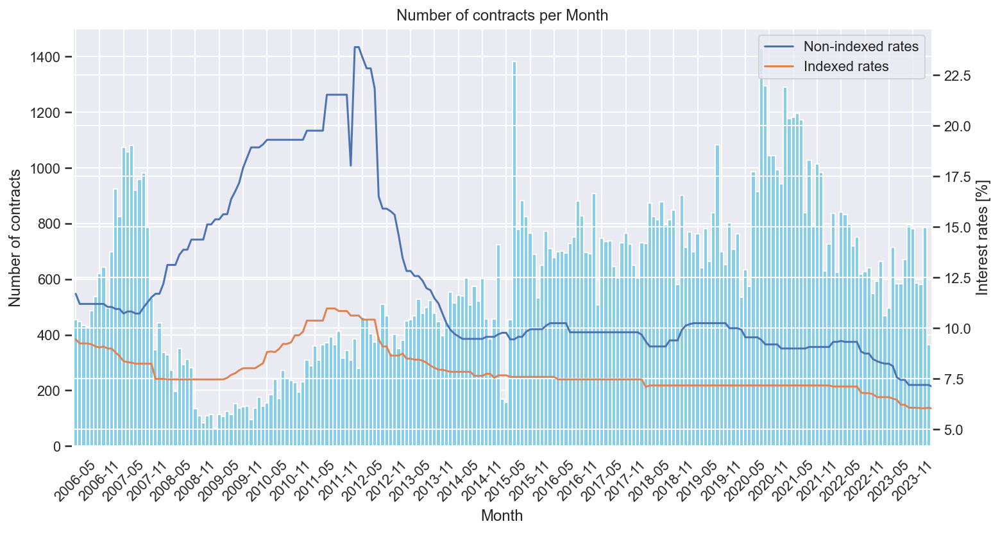

In [74]:
line_data = pd.DataFrame()
line_data['Non-indexed rates'] = (interest_rates['non-indexed rates - highest'] + interest_rates['non-indexed rates - lowest'])/2
line_data['Indexed rates'] = (interest_rates['indexed rates - highest'] + interest_rates['indexed rates - lowest'])/2

line_data['Indexed rates']

data_monthly_counts = data.copy()
data_monthly_counts['year_month'] = data['notarized_date'].dt.to_period('M')
data_monthly_counts.sort_values(by='year_month', ascending=False)

monthly_counts = data_monthly_counts['year_month'].value_counts().sort_index()

# Plot the data
plt.figure(figsize=(12, 6))  # Set the figure size for better readability

# Create the first y-axis for the bar chart
ax1 = plt.gca()
ax1.grid(False)

# Adjust the width of the bars to make them closer together
bar_width = 1
monthly_counts.plot(kind='bar', color='skyblue', width=bar_width, align='center', ax=ax1)  # Create a bar chart

# Add labels and formatting for the bar chart
plt.title('Number of contracts per Month')
plt.xlabel('Month')
plt.ylabel('Number of contracts')

# Set x-axis ticks to display every other month
x_ticks = range(0, len(monthly_counts), 6)
plt.xticks(x_ticks, monthly_countss.index[x_ticks].strftime('%Y-%m'), rotation=45)  # Rotate and format x-axis labels

# Create the second y-axis for the lines
ax2 = ax1.twinx()
ax2.set_ylabel('Interest rates [%]')
ax2.grid(False)

# Plot the lines (assuming line_interest and line_policy are dictionaries containing line data per month)
for line_name, line_data in line_data.items():
    line_data.plot(ax=ax2, label=line_name)

# Add legend for the lines
ax2.legend(loc='upper right')

# Show the plot
plt.show()


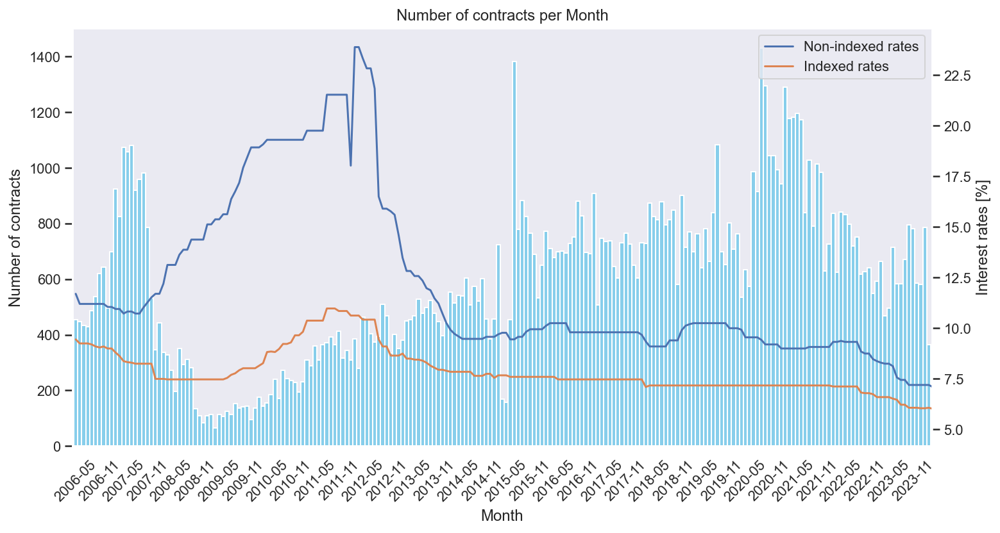

In [82]:
import matplotlib.pyplot as plt

# Assuming 'data' is your DataFrame with a 'notarized_date' column
data_monthly_counts = data.copy()
data_monthly_counts['year_month'] = data['notarized_date'].dt.to_period('M')
data_monthly_counts.sort_values(by='year_month', ascending=False)

monthly_counts = data_monthly_counts['year_month'].value_counts().sort_index()

# Create line data
line_data = pd.DataFrame()
line_data['Non-indexed rates'] = (interest_rates['non-indexed rates - highest'] + interest_rates['non-indexed rates - lowest']) / 2
line_data['Indexed rates'] = (interest_rates['indexed rates - highest'] + interest_rates['indexed rates - lowest']) / 2

# Plot the data
plt.figure(figsize=(12, 6))  # Set the figure size for better readability

# Create the first y-axis for the bar chart
ax1 = plt.gca()

# Adjust the width of the bars to make them closer together
bar_width = 1
monthly_counts.plot(kind='bar', color='skyblue', width=bar_width, align='center', ax=ax1)  # Create a bar chart

# Add labels and formatting for the bar chart
plt.title('Number of contracts per Month')
plt.xlabel('Month')
plt.ylabel('Number of contracts')

# Set x-axis ticks to display every other month
x_ticks = range(0, len(monthly_counts), 6)
plt.xticks(x_ticks, monthly_counts.index[x_ticks].strftime('%Y-%m'), rotation=45)  # Rotate and format x-axis labels

# Create the second y-axis for the lines
ax2 = ax1.twinx()
ax2.set_ylabel('Interest rates [%]')


# Plot the lines
for line_name, line_data in line_data.items():
    line_data.plot(ax=ax2, label=line_name)

# Add legend for the lines
ax2.legend(loc='upper right')


# Disable grid lines for both axes
ax1.grid(False)
ax2.grid(False)

# Show the plot
plt.show()


#### Number of rooms - Size of apartments

In [58]:
data['size_square_meters']

1         139.8
2         102.3
9          55.0
10        203.6
11         55.0
          ...  
192994    204.4
192995     80.2
192996     82.4
192997    135.7
193004     91.5
Name: size_square_meters, Length: 126139, dtype: float64

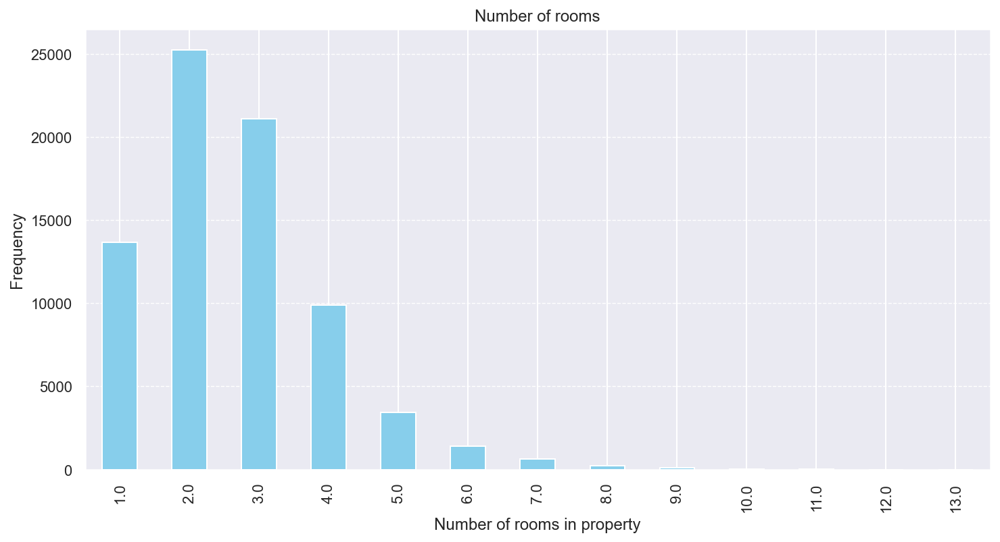

In [60]:
# Extract unique properties
unique_ids = data['property_number'].unique()
unique_properties = data.drop_duplicates(subset=['property_number'])
unique_properties = unique_properties[(unique_properties['number_of_rooms'] != 0) & (unique_properties['number_of_rooms'] < 14)]
rooms_count = unique_properties['number_of_rooms'].value_counts()


# Sort the number of rooms
rooms_count = rooms_count.sort_index()

# Plot the data
plt.figure(figsize=(12, 6))  # Set the figure size for better readability
rooms_count.plot(kind='bar', color='skyblue')  # Create a bar chart
plt.title('Number of rooms')
plt.xlabel('Number of rooms in property')
plt.ylabel('Frequency')
plt.xticks(rotation=90)  # Rotate x-axis labels for better readability
plt.grid(axis='y', linestyle='--', linewidth=0.7)  # Add horizontal grid lines
plt.show()

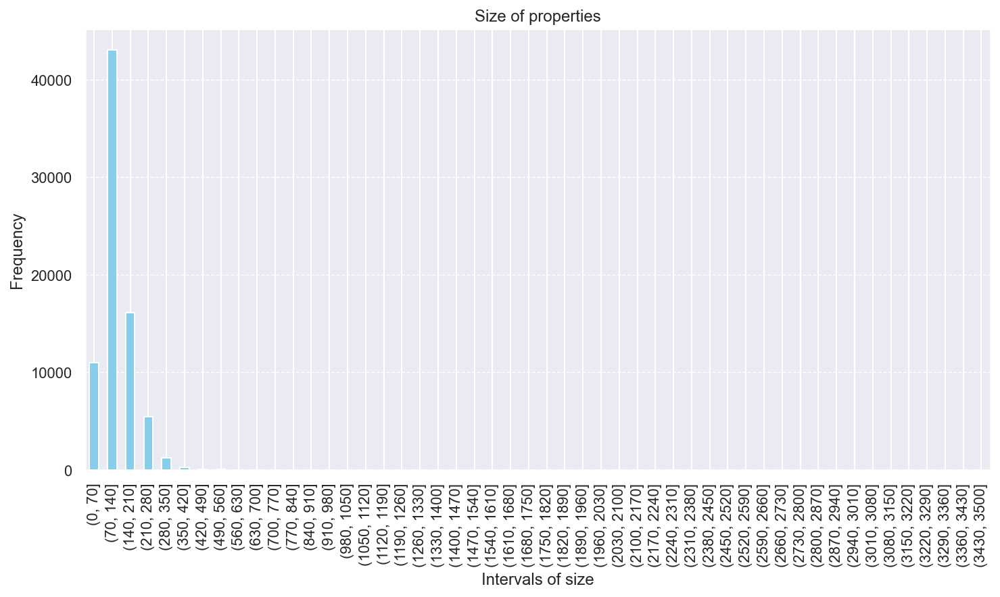

In [61]:
# Unique properties
unique_ids = data['property_number'].unique()
unique_properties = data.drop_duplicates(subset=['property_number'])

bin_size = 70

# Bin the values
max_size = int(unique_properties['size_square_meters'].max())
bins = pd.cut(unique_properties['size_square_meters'], bins=range(0, max_size + bin_size, bin_size))
# Count the occurrences of each interval
size_count = bins.value_counts().sort_index()

# Plot the data
plt.figure(figsize=(12, 6))  # Set the figure size for better readability
size_count.plot(kind='bar', color='skyblue')  # Create a bar chart
plt.title('Size of properties')
plt.xlabel('Intervals of size')
plt.ylabel('Frequency')
plt.xticks(rotation=90)  # Rotate x-axis labels for better readability
plt.grid(axis='y', linestyle='--', linewidth=0.7)  # Add horizontal grid lines
plt.show()

It's not the best way to see the distribution of the size of apartments sold...so let's take out the apartments that are absurdily big...350 $m^2$ must be considered a good upper bound on what could be considered as a normal size...

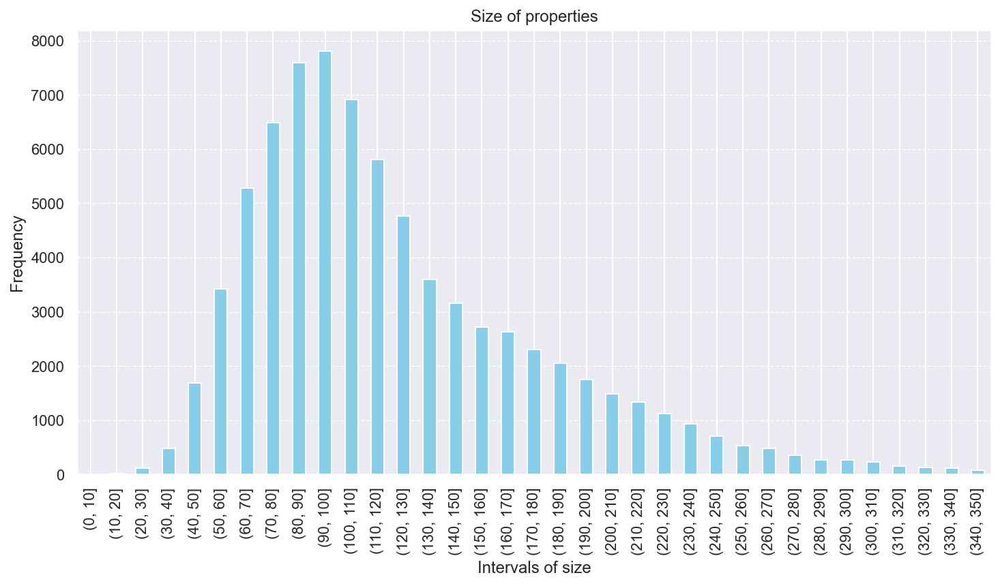

In [62]:
# Unique properties
unique_ids = data['property_number'].unique()
unique_properties = data.drop_duplicates(subset=['property_number'])
unique_properties = unique_properties[unique_properties['size_square_meters'] < 350]

bin_size = 10

# Bin the values
max_size = int(unique_properties['size_square_meters'].max())
bins = pd.cut(unique_properties['size_square_meters'], bins=range(0, max_size + bin_size, bin_size))
# Count the occurrences of each interval
size_count = bins.value_counts().sort_index()

# Plot the data
plt.figure(figsize=(12, 6))  # Set the figure size for better readability
size_count.plot(kind='bar', color='skyblue')  # Create a bar chart
plt.title('Size of properties')
plt.xlabel('Intervals of size')
plt.ylabel('Frequency')
plt.xticks(rotation=90)  # Rotate x-axis labels for better readability
plt.grid(axis='y', linestyle='--', linewidth=0.7)  # Add horizontal grid lines
plt.show()

much better, as we are looking at the number of properties sold on a 10 $m^2$ interval, it's apparent that majority of properties are from 60-150 $m^2$. What about if we look at different municipalities or different types of houses?

### Best buy over the years?
Calculating the "best buy" for each property, only looking at the difference of `purchase_price` and `current_property_value` from the time the property was last bought, getting percentage, `value_change`, indicating the percentage change in value of the property. We could have also looked at the purchase price, but for the grand scheme of things, that value is not important as most property purchases in Iceland are influenced by the property value, often times only going couple of millions kr. above or below the property value. Not the case for every property but for this analysis we made that simplification. Focusing on the capital region

In [63]:
data.head()

#--- Filter out older records of purchases, only getting the newest record per property ---#

# Drop all rows where the year is 2024, as for those bought in 2024 would have 0% change, having the same property value in both columns we are looking at
data_filtered = data[(data['notarized_date'].dt.year != 2024) & (data['notarized_date'].dt.year > 2015)]
# Also filtering out where the property has not been completed when is was bought, as the price for that house would not reflect the property value
# The property_value would be much less if the house was not completed so getting a huge percentage change
data_filtered = data_filtered[data_filtered['complete'] == 1]
# And excluding summer houses...not relevant
data_filtered = data_filtered[data_filtered['type'] != 'Summer house']
# Capital region
data_filtered = data_filtered[data_filtered['postal_code'].isin(capital_region_postal_codes)]

# Sort the data by the date column in descending order, getting the newest date
data_sorted = data_filtered.sort_values(by='notarized_date', ascending=False)

# Keep only the first occurrence of each property number
data_filtered = data_sorted.drop_duplicates(subset='property_number')



In [66]:
# Calculate the percentage value change
data_filtered['value_change'] = ((data_filtered['current_property_value'] - data_filtered['purchase_price'])/data_filtered['purchase_price'])*100

# Sorting to get top 100 properties
data_calculated = data_filtered[data_filtered['value_change'] < 500] # some houses have absurdily low purchase prices
top_n_value_changes = data_calculated.sort_values(by='value_change', ascending=False).head(30)

In [67]:
top_n_value_changes

,property_number,address,postal_code,municipality,notarized_date,purchase_price,property_value,current_property_value,insurance_payout,year_built,size_square_meters,plot_size,plot_size_units,number_of_rooms,type,unenforcable_contract,latitude,longitude,complete,price_per_sq_meter,log_purchase_price,year_month,value_change
102974,2020137,Langholtsvegur 44,104,Reykjavíkurborg,2018-05-09 10:43:01,25000,77500,136550.0,101210.0,1946,236.0,530.3,m²,5.0,Apartment,0,64.142736,-21.860625,1,105.932203,4.397940,2018-05,446.200000
102454,2047840,Hjaltabakki 18,109,Reykjavíkurborg,2016-11-14 11:13:04,11000,20700,51150.0,43000.0,1968,90.1,7337.0,m²,2.0,Apartment,0,64.107976,-21.830165,1,122.086570,4.041393,2016-11,365.000000
160944,2062904,Marbakkabraut 9A,200,Kópavogsbær,2018-04-12 09:54:29,35000,49850,146450.0,144750.0,1948,135.2,814.0,m²,5.0,Private house,0,64.114911,-21.907372,1,258.875740,4.544068,2018-04,318.428571
176494,2059416,Bæjartún 11,200,Kópavogsbær,2020-11-25 12:39:47,37500,93000,148550.0,124550.0,1984,292.6,462.0,m²,6.0,Private house,0,64.114280,-21.865668,1,128.161312,4.574031,2020-11,296.133333
159296,2069917,Eskiholt 12,210,Garðabær,2018-01-08 13:40:48,48000,93800,186650.0,141950.0,1988,323.5,775.0,m²,7.0,Private house,0,64.091671,-21.888610,1,148.377125,4.681241,2018-01,288.854167
159303,2248433,Barðastaðir 59,112,Reykjavíkurborg,2018-01-09 11:01:29,29000,58450,112700.0,63650.0,2000,153.0,850.0,m²,3.0,Private house,0,64.159923,-21.750795,1,189.542484,4.462398,2018-01,288.620690
151030,2061095,Grænatunga 5,200,Kópavogsbær,2016-10-12 12:50:50,9500,12950,36200.0,19500.0,1966,41.0,1065.0,m²,1.0,Apartment,0,64.109529,-21.897234,1,231.707317,3.977724,2016-10,281.052632
167153,2054135,Staðarsel 2,109,Reykjavíkurborg,2019-04-01 11:51:09,12500,28500,46350.0,39000.0,1978,67.6,705.0,m²,1.0,Apartment,0,64.098489,-21.852822,1,184.911243,4.096910,2019-04,270.800000
81233,2282598,Faxahvarf 2,203,Kópavogsbær,2019-01-14 11:16:46,50346,101200,181150.0,136490.0,2006,309.6,692.0,m²,4.0,Private house,0,64.089631,-21.803988,1,162.616279,4.701965,2019-01,259.810114
92240,2312283,Gerplustræti 27,270,Mosfellsbær,2021-06-23 12:27:20,25000,59550,89500.0,74950.0,2008,151.3,4135.0,m²,4.0,Apartment,0,64.168509,-21.662992,1,165.234633,4.397940,2021-06,258.000000


In [71]:
import pandas as pd
import numpy as np
import folium


# Create a list of colors
colors = ['red', 'blue', 'green', 'orange', 'purple', 'yellow', 'cyan', 'magenta', 'lime', 'pink']

# Finally, creating the map
iceland_map = folium.Map(location=[64.128288, -21.827774], zoom_start=11, tiles='CartoDB Positron')

for idx, (index, row) in enumerate(top_n_value_changes.iterrows()):
    tooltip_text = f"Address: {row['address']}<br>"
    tooltip_text += f"Type: {row['type']}<br>"
    tooltip_text += f"Purchase price: {row['purchase_price']:,} ISK<br>"
    tooltip_text += f"Property value when buying: {row['property_value']:,} ISK<br>"
    tooltip_text += f"Current property value: {row['current_property_value']:,} ISK<br>"
    tooltip_text += f"Last Purchase Date: {row['notarized_date']}<br>"
    tooltip_text += f"Percentage value change: {row['value_change']:.2f} %"
    
    color_index = idx % len(colors)  # Use modulo operator to cycle through colors
    color = colors[color_index]
    
    folium.Circle(
        location=[row['latitude'], row['longitude']],
        radius=row['value_change']*0.5,  # Adjust radius size for better visualization
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.75,
        tooltip=folium.Tooltip(tooltip_text, permanent=False) 
    ).add_to(iceland_map)

iceland_map


In [72]:
import pandas as pd
import numpy as np
import folium
from sklearn.neighbors import BallTree

# Ensure the data is sorted by date
data_sorted = data.sort_values(by='notarized_date', ascending=False).copy()

# Remove duplicate entries 
data_unique = data_sorted.drop_duplicates(subset=['property_number']).copy()
data_unique['notarized_date'] = data_unique['notarized_date'].dt.date

# Oldest houses, top n
data_sorted_oldest = data_unique[~data_unique['year_built'].isin([0])].sort_values(by='year_built', ascending=True).head(100)

# Define color scale
min_year_built = data_sorted_oldest['year_built'].min()
max_year_built = data_sorted_oldest['year_built'].max()
colors = ['#3A4CC0', '#6A7FD2', '#9CB0E4', '#C9DAF6', '#FEDA8B', '#FDB366', '#FC8D49', '#F03B20', '#D9210E']
color_scale = LinearColormap(colors, vmin=min_year_built, vmax=max_year_built)
color_scale.caption = 'Year Built'

# Create the map
iceland_map = folium.Map(location=[64.9631, -19.0208], zoom_start=6, tiles='CartoDB Positron')

# Create feature groups for each year built range
year_ranges = [(1800, 1900), (1901, 1920), (1921, 1940), (1941, 1960), (1961, 1980), (1981, 2000), (2001, 2020)]
feature_groups = {f"{start}-{end}": folium.FeatureGroup(name=f"{start}-{end}", show=True) for start, end in year_ranges}



for idx, row in data_sorted_oldest.iterrows():
    tooltip_text = f"Address: {row['address']}<br>"
    tooltip_text += f"Type: {row['type']}<br>"
    tooltip_text += f"Purchase Price: {row['purchase_price']:,} m ISK<br>"
    tooltip_text += f"Year Built: {row['year_built']}<br>"
    tooltip_text += f"Last Purchase Date: {row['notarized_date']}<br>"

    # Map the year built to a color
    color = color_scale(row['year_built'])

    # Modify the keys in the feature_groups dictionary to use individual year values as strings
    feature_groups = {str(year): folium.FeatureGroup(name=str(year), show=True) for year in range(min_year_built, max_year_built + 1)}

    # Use individual year values as keys when accessing the feature groups
    folium.Circle(
        location=[row['latitude'], row['longitude']],
        radius=row['year_built'] * 0.1,  # Adjust radius size for better visualization
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.75,
        tooltip=folium.Tooltip(tooltip_text, permanent=False)).add_to(feature_groups[str(row['year_built'])])

    
    # folium.Circle(
    #     location=[row['latitude'], row['longitude']],
    #     radius=row['year_built'] * 0.1,  # Adjust radius size for better visualization
    #     color=color,
    #     fill=True,
    #     fill_color=color,
    #     fill_opacity=0.75,
    #     tooltip=folium.Tooltip(tooltip_text, permanent=False)).add_to(feature_groups[f"{row['year_built']}"])

# Add feature groups to the map
for fg in feature_groups.values():
    fg.add_to(iceland_map)

# Add the color scale to the map
iceland_map.add_child(color_scale)

# Add layer control to toggle year built ranges
folium.LayerControl(collapsed=False).add_to(iceland_map)

iceland_map


NameError: name 'LinearColormap' is not defined

In [73]:
import pandas as pd
import numpy as np
import folium
from branca.colormap import LinearColormap

# Assuming 'data' is your DataFrame
# Ensure the data is sorted by date
data_sorted = data.sort_values(by='notarized_date', ascending=False).copy()

# Remove duplicate entries 
data_unique = data_sorted.drop_duplicates(subset=['property_number']).copy()
data_unique['notarized_date'] = data_unique['notarized_date'].dt.date

# Oldest houses, top n
data_sorted_oldest = data_unique[~data_unique['year_built'].isin([0])].sort_values(by='year_built', ascending=True).head(30)

# Define color scale
min_year_built = data_sorted_oldest['year_built'].min()
max_year_built = data_sorted_oldest['year_built'].max()
colors = ['#3A4CC0', '#6A7FD2', '#9CB0E4', '#C9DAF6', '#FEDA8B', '#FDB366', '#FC8D49', '#F03B20', '#D9210E']
color_scale = LinearColormap(colors, vmin=min_year_built, vmax=max_year_built)
color_scale.caption = 'Year Built'

# Create the map
iceland_map = folium.Map(location=[64.9631, -19.0208], zoom_start=6, tiles='CartoDB Positron')

for idx, row in data_sorted_oldest.iterrows():
    tooltip_text = f"Address: {row['address']}<br>"
    tooltip_text += f"Type: {row['type']}<br>"
    tooltip_text += f"Purchase Price: {row['purchase_price']:,} m ISK<br>"
    tooltip_text += f"Year Built: {row['year_built']}<br>"
    tooltip_text += f"Last Purchase Date: {row['notarized_date']}<br>"

    # Map the year built to a color
    color = color_scale(row['year_built'])

    folium.Circle(
        location=[row['latitude'], row['longitude']],
        radius=row['year_built'] * 0.05,  # Adjust radius size for better visualization
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.75,
        tooltip=folium.Tooltip(tooltip_text, permanent=False)).add_to(iceland_map)

# Add the color scale to the map
iceland_map.add_child(color_scale)

# Show the map
iceland_map


# Genre
Which genre of data story did you use?
- Which tools did you use from each of the 3 categories of Visual Narrative (Figure 7 in Segal and Heer). Why?
- Which tools did you use from each of the 3 categories of Narrative Structure (Figure 7 in Segal and Heer). Why?


# Visualizations
- Explain the visualizations you've chosen.
- Why are they right for the story you want to tell?


# Discussion
Think critically about your creation
What went well?,
What is still missing? What could be improved?, Why?

# Contributions
Who did what?
- You should write (just briefly) which group member was the main responsible for which elements of the assignment. (I want you guys to understand every part of the assignment, but usually there is someone who took lead role on certain portions of the work. That's what you should explain).
- It is not OK simply to write "All group members contributed equally".